In [1]:
DATA_DIR = '/storage/groups/ml01/workspace/louis.kuemmerle/projects/A1/data2/'
DATA_VERSION = 'april21'

In [2]:
import os 
import numpy as np
import scipy as sci
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as pl

import scanpy as sc
import anndata as ann

from scipy.sparse import csr_matrix
from matplotlib import rcParams
from matplotlib import colors


sc.settings.verbosity = 3
sc.logging.print_versions()

-----
anndata     0.7.5
scanpy      1.6.1
sinfo       0.3.1
-----
PIL                 8.1.0
anndata             0.7.5
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              1.0.9
certifi             2020.12.05
cffi                1.14.4
chardet             4.0.0
cloudpickle         1.6.0
constants           NA
cycler              0.10.0
cython_runtime      NA
dask                2020.12.0
dateutil            2.8.1
decorator           4.4.2
future_fstrings     NA
get_version         2.1
google              NA
h5py                2.10.0
highs_wrapper       NA
idna                2.10
igraph              0.8.3
ipykernel           5.4.3
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.2
joblib              1.0.0
json5               NA
jsonschema          3.2.0
jupyter_server      1.2.1
jupyterlab_server   2.1.2
kiwisolver          1.3.1
legacy_api_wrap     1.2
leidenalg

In [3]:
sc.settings.set_figure_params(dpi=70)
sc.settings.verbosity = 3
sc.settings.n_jobs = 3
sc.set_figure_params(vector_friendly=True,color_map='viridis',dpi_save=600,transparent=True)

# Introduction

In this notebook, we annotate Ali Ertürk's skull data. The full dataset consists of 24 samples from various sources in the mouse skeleton.

We perform the following steps:
1. Load the data
2. Visualise
3. Check for Batch Effects and correct, if necessary
4. Visualise again, cluster, get characteristics

# Load data

In [4]:
adata = sc.read(DATA_DIR+f'data_norm_{DATA_VERSION}_wSham.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 147347 × 17101
    obs: 'sample_id', 'batch', 'sample_name', 'region', 'condition', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'size_factors'
    uns: 'sample_name_colors'

Check the contributions per sample.

In [6]:
pd.crosstab(adata.obs['region'], adata.obs['condition'])

condition,MCAO,Naive,Sham
region,,,
Brain,1811,506,505
Femur,15373,7771,6047
Humerus,12396,6545,4642
Meninges,5852,2126,1246
Pelvis,12172,6567,6162
Scapula,8423,6751,3853
Skull,10457,4955,4417
Vertebra,13481,3448,1841


Remove mitochondrial reads.

In [7]:
mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
mt_gene_index = np.where(np.invert(mt_gene_mask))[0]
adata=adata[:, mt_gene_index]

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


# Highly variable genes

In [8]:
sc.pp.highly_variable_genes(adata, batch_key='sample_name', flavor='cell_ranger', n_top_genes=4000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args

    finished (0:01:41)


/opt/python/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:504: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.
  df.loc[:n_top_genes, 'highly_variable'] = True
Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


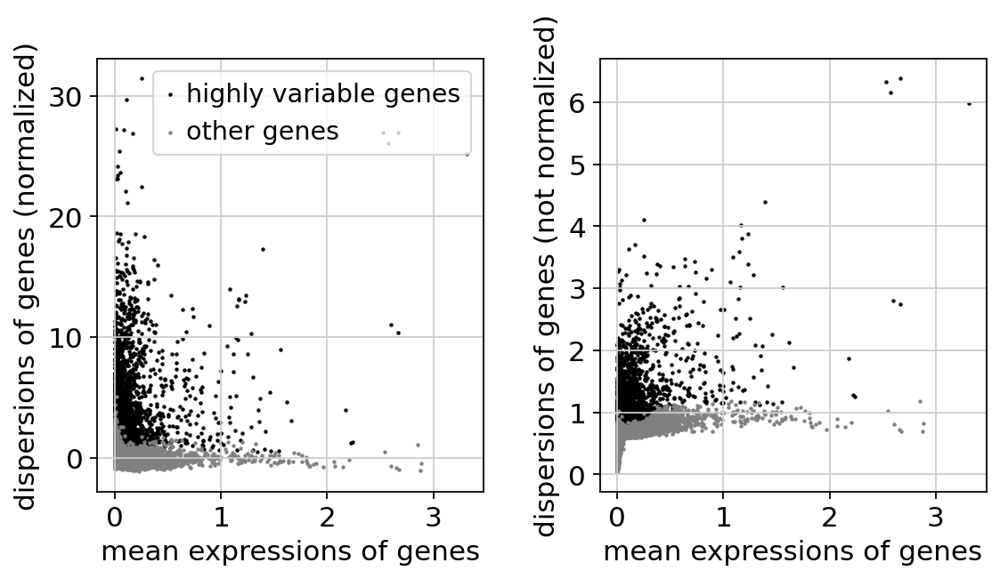

In [9]:
sc.pl.highly_variable_genes(adata)

# First visualisation

In [10]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=0.5)
sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished (0:02:22)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:19)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:36)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:48)


In [11]:
sc.tl.leiden(adata, resolution = 2, key_added='leiden_high_res')

running Leiden clustering
    finished: found 49 clusters and added
    'leiden_high_res', the cluster labels (adata.obs, categorical) (0:02:24)


In [12]:
sc.tl.leiden(adata, resolution = 3, key_added='leiden_res_3')

running Leiden clustering
    finished: found 61 clusters and added
    'leiden_res_3', the cluster labels (adata.obs, categorical) (0:02:28)


In [13]:
sc.tl.leiden(adata, resolution = 4, key_added='leiden_res_4')

running Leiden clustering
    finished: found 80 clusters and added
    'leiden_res_4', the cluster labels (adata.obs, categorical) (0:03:01)


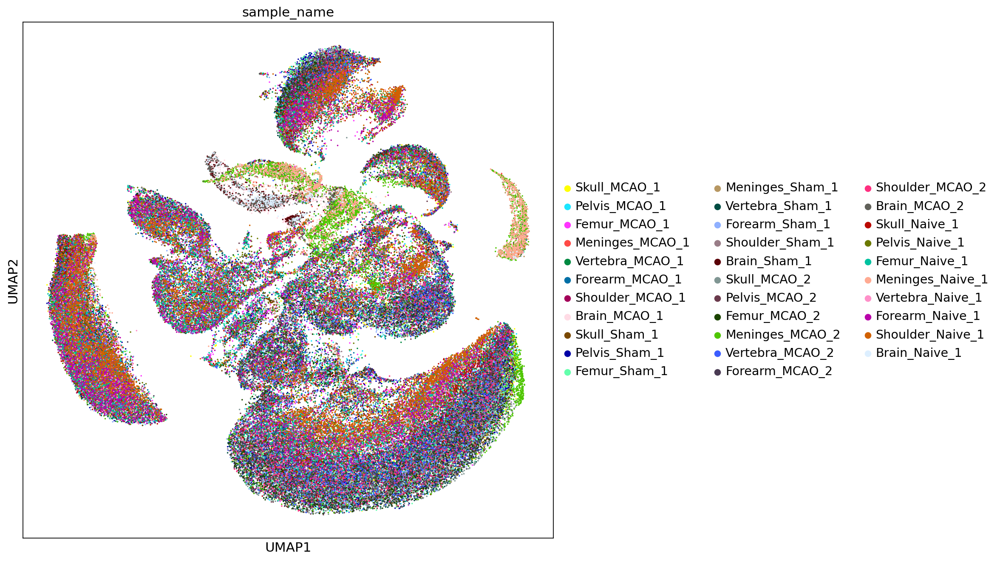

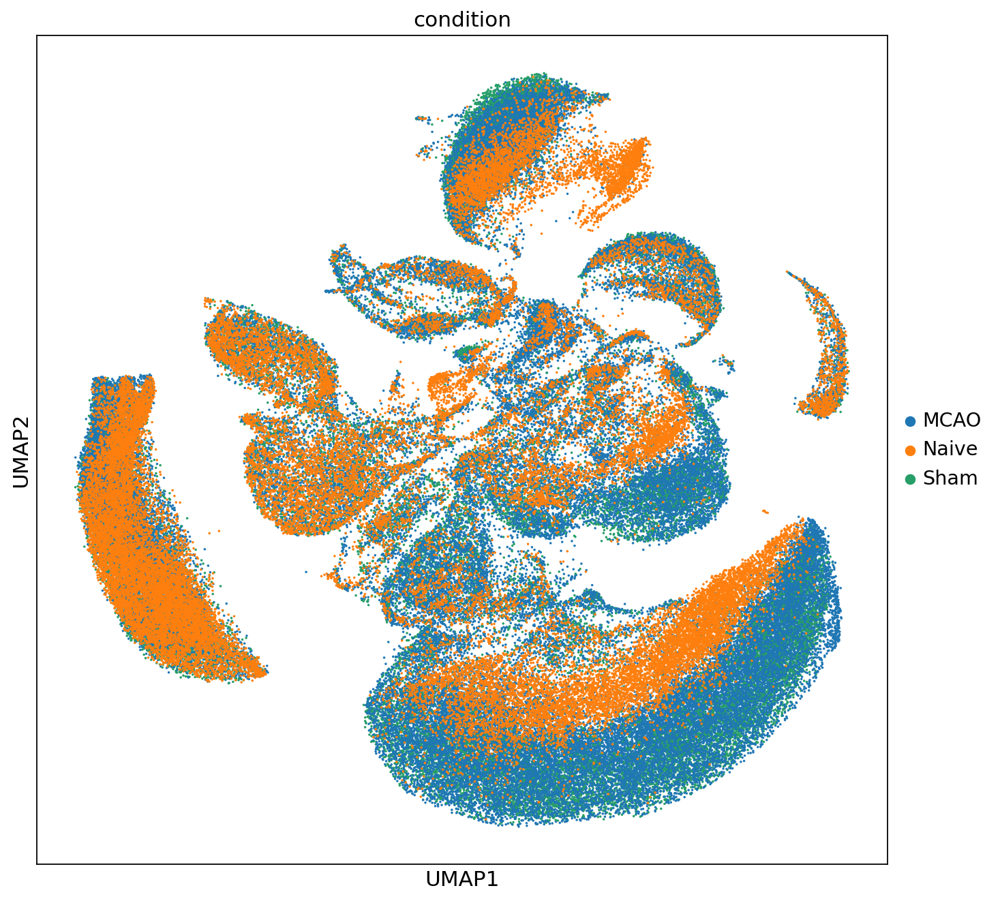

In [14]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata, color='sample_name', size=10)
sc.pl.umap(adata, color='condition', size=10)

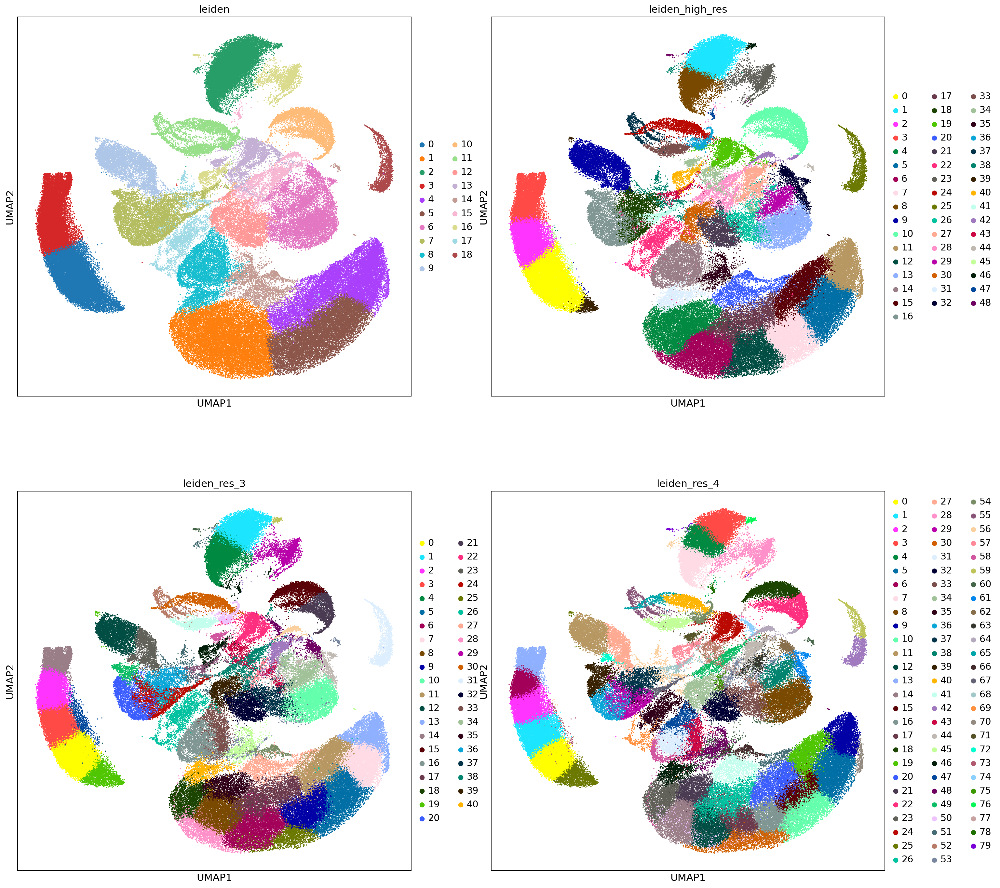

In [15]:
sc.pl.umap(adata, color=['leiden','leiden_high_res','leiden_res_3','leiden_res_4'],ncols=2,size=10)

## Compute cell cycle score

In [16]:
path_resource = '/storage/groups/ml01/workspace/maren.buettner/data_integration/'
g2m_genes = pd.read_csv(path_resource + 'Benchmarking_data_integration/scIB/resources/g2m_genes_tirosh.txt')
s_genes = pd.read_csv(path_resource + 'Benchmarking_data_integration/scIB/resources/s_genes_tirosh.txt')

In [17]:
sc.tl.score_genes_cell_cycle(adata, g2m_genes=g2m_genes, s_genes=s_genes)

calculating cell cycle phase
computing score 'S_score'


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished: added
    'S_score', score of gene set (adata.obs).
    42 total control genes are used. (0:00:37)
computing score 'G2M_score'


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished: added
    'G2M_score', score of gene set (adata.obs).
    42 total control genes are used. (0:00:33)
-->     'phase', cell cycle phase (adata.obs)


In [18]:
adata

AnnData object with n_obs × n_vars = 147347 × 17088
    obs: 'sample_id', 'batch', 'sample_name', 'region', 'condition', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'size_factors', 'leiden', 'leiden_high_res', 'leiden_res_3', 'leiden_res_4', 'S_score', 'G2M_score', 'phase'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'sample_name_colors', 'hvg', 'pca', 'neighbors', 'leiden', 'umap', 'condition_colors', 'leiden_colors', 'leiden_high_res_colors', 'leiden_res_3_colors', 'leiden_res_4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [19]:
adata.obs['phase'].value_counts()

G2M    86216
G1     35120
S      26011
Name: phase, dtype: int64

# Evaluate batch effects

## Full data set

Here, we compute the variance contribution of the condition, region and cell cycle to the data. It must be noted, that the conditions are not purely technical, therefore, we will also test for batch effects in the MACO condition (see below).

In [20]:
pca = sc.tl.pca(adata.X, n_comps=50, use_highly_variable=False,
                return_info=True, svd_solver='arpack', copy=True)
X_pca = pca[0].copy()
pca_sd = pca[3].copy()

computing PCA
    with n_comps=50
    finished (0:07:30)


In [21]:
R2Var = dict()
# fit linear model for n_comps PCs
from sklearn.linear_model import LinearRegression

n_comps = adata.obsm['X_pca'].shape[1]


batch = adata.obs['phase'].astype('category').cat.codes
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)

r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['phase'] = sum(r2*Var)/100

batch = adata.obs['region']
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)

r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['region'] = sum(r2*Var)/100


batch = adata.obs['condition']
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)


r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['condition'] = sum(r2*Var)/100


In [22]:
R2Var

{'phase': 0.04987611375833975,
 'region': 0.0019992383106294527,
 'condition': 0.014560046351255247}

Cell cycle has the strongest influence on the data, followed by the region and then the condition, however, the condition contribution to the variance seems very small. 

## Using replicates only

We have a visible batch effect for the respective conditions, but I am not sure, whether this effect is desired and caused by biological changes. 

In order to evaluate the batch effect partly, I'll compare the MACO samples (called MACO and MCAO). 

In [23]:
adata_MACO = adata[np.in1d(adata.obs['condition'], ['MCAO'])].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [24]:
tmp_rep = [idx.split('_')[-1] for idx in adata_MACO.obs['sample_name']]

In [25]:
adata_MACO.obs['replicate'] = tmp_rep

In [26]:
pca = sc.tl.pca(adata_MACO.X, n_comps=50, use_highly_variable=False,
                return_info=True, svd_solver='arpack', copy=True)
X_pca = pca[0].copy()
pca_sd = pca[3].copy()

computing PCA
    with n_comps=50
    finished (0:04:13)


In [27]:
R2Var = dict()
# fit linear model for n_comps PCs
from sklearn.linear_model import LinearRegression

n_comps = adata_MACO.obsm['X_pca'].shape[1]


batch = adata_MACO.obs['phase'].astype('category').cat.codes
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)

r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['phase'] = sum(r2*Var)/100

batch = adata_MACO.obs['region']
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)

r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['region'] = sum(r2*Var)/100


batch = adata_MACO.obs['replicate']
batch = pd.get_dummies(batch) if 'category' == str(batch.dtype) else np.array(batch)


r2 = []
for i in range(n_comps):
    lm = LinearRegression()
    lm.fit(X_pca[:, [i]], batch)
    r2.append(lm.score(X_pca[:, [i]], batch))
    
Var = pca_sd**2 / sum(pca_sd**2) * 100
R2Var['replicate'] = sum(r2*Var)/100


In [28]:
R2Var

{'phase': 0.049066682758501255,
 'region': 0.002177211344658623,
 'replicate': 0.0015295194287859599}

The evaluation shows that the cell cycle score contributes the most to the variation, followed by the region and the condition (which corresponds to the batch effect in the technical sense). Thus, we do not correct for batch effects.

# Characterize clusters

In [29]:
sc.tl.rank_genes_groups(adata, groupby='leiden', method='t-test_overestim_var')

ranking genes


... storing 'phase' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:13:31)


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


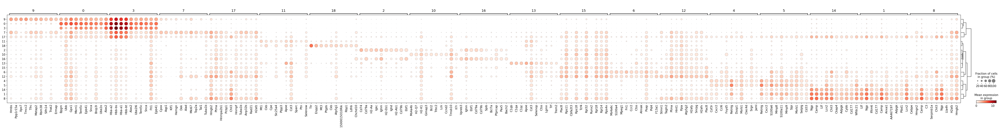

In [30]:
sc.pl.rank_genes_groups_dotplot(adata)

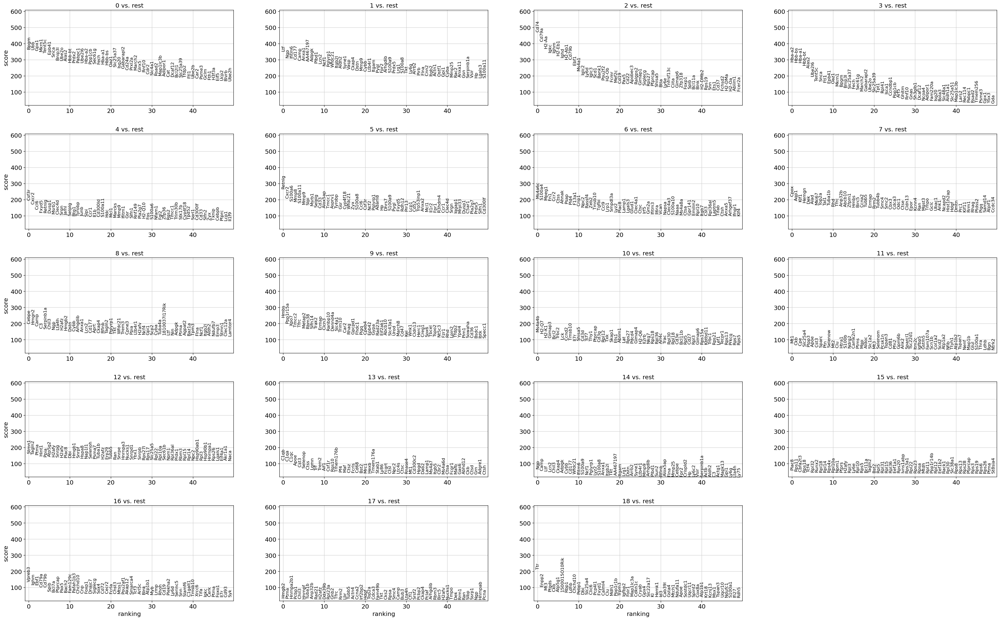

In [31]:
rcParams['figure.figsize']=(10,5)
sc.pl.rank_genes_groups(adata, fontsize =10, n_genes=50)

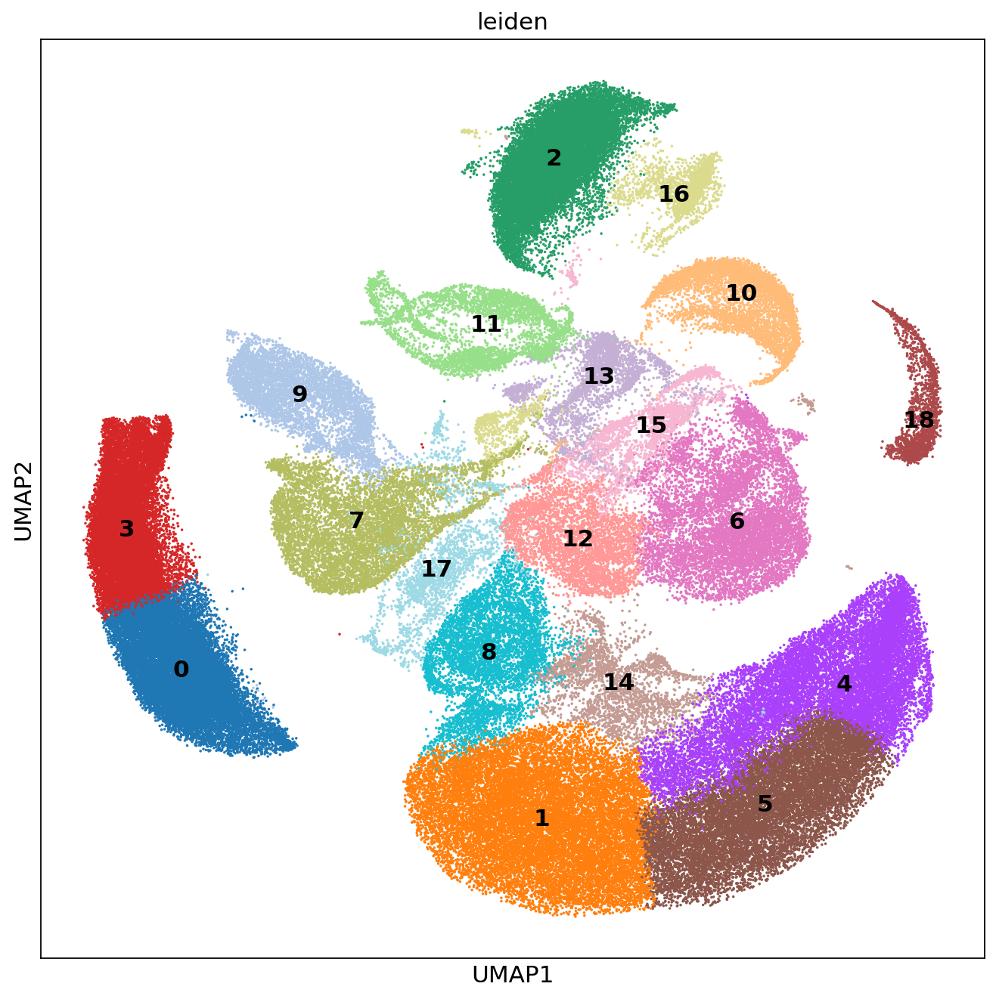

In [32]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata, color='leiden', size=10, legend_loc='on data')

### Remap old celltype annotations to new data

In [39]:
adata_old = sc.read(DATA_DIR+'cellxgene_dec20_wSham.h5ad')

In [40]:
adata.obs['cell_types_old'] = 'no mapping'
adata.obs.loc[adata.obs_names.isin(adata_old.obs_names),'cell_types_old'] = adata_old.obs['cell_types'].copy()

In [41]:
del adata_old

... storing 'cell_types_old' as categorical


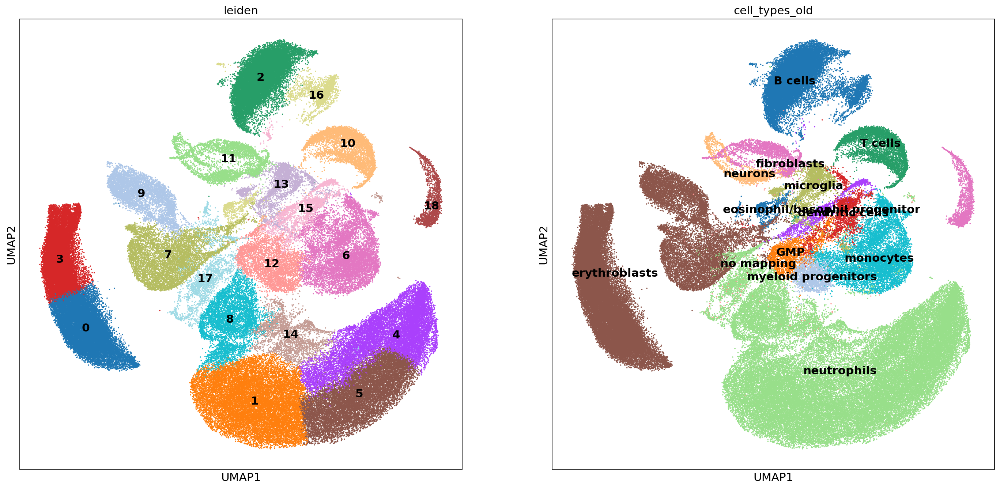

In [42]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata, color=['leiden','cell_types_old'], size=10, legend_loc='on data')

In [43]:
leiden_mapping = {}
for i in range(max([int(l) for l in adata.obs['leiden'].unique()])):
    leiden_mapping[str(i)] = adata.obs.loc[adata.obs['leiden'] == str(i),'cell_types_old'].value_counts().idxmax()

In [44]:
pd.DataFrame(index=leiden_mapping,data=[v for _,v in leiden_mapping.items()])

,0
0,erythroblasts
1,neutrophils
2,B cells
3,erythroblasts
4,neutrophils
5,neutrophils
6,monocytes
7,erythroblasts
8,neutrophils
9,erythroblasts


## Visualise marker genes

## Annotate clusters (thanks to the tremendous effort of Ilgin!)

- 0,3 -> erythrocytes
- 9 -> erythroblasts
- 8, 20 -> erythroblasts and progenitors
- 1,4,5 -> neutrophils
- 2 -> B cells
- 11, 18 -> fibroblasts
- 10 -> T cells 
- none -> NK cells 
- none -> dendritic cells/monocytes 
- 6,7,8,11,12,13,14,15,16,17 -> progenitors


In [48]:
annotate_dict={
'0' : 'erythrocytes',
'1' : 'neutrophils', 
'2' : 'B cells',
'3' : 'erythrocytes', 
'4' : 'neutrophils', 
'5' : 'neutrophils',
'6' : 'progenitors',
'7' : 'progenitors',
'8' : 'progenitors', 
'9' : 'erythroblasts', 
'10' : 'T cells', 
'11' : 'fibroblasts',
'12' : 'progenitors',
'13' : 'progenitors',
'14' : 'progenitors',
'15' : 'progenitors',
'16' : 'progenitors',
'17' : 'progenitors',
'18' : 'fibroblasts',
}

In [49]:
adata.obs['annotated'] = adata.obs['leiden'].map(annotate_dict).astype('category')

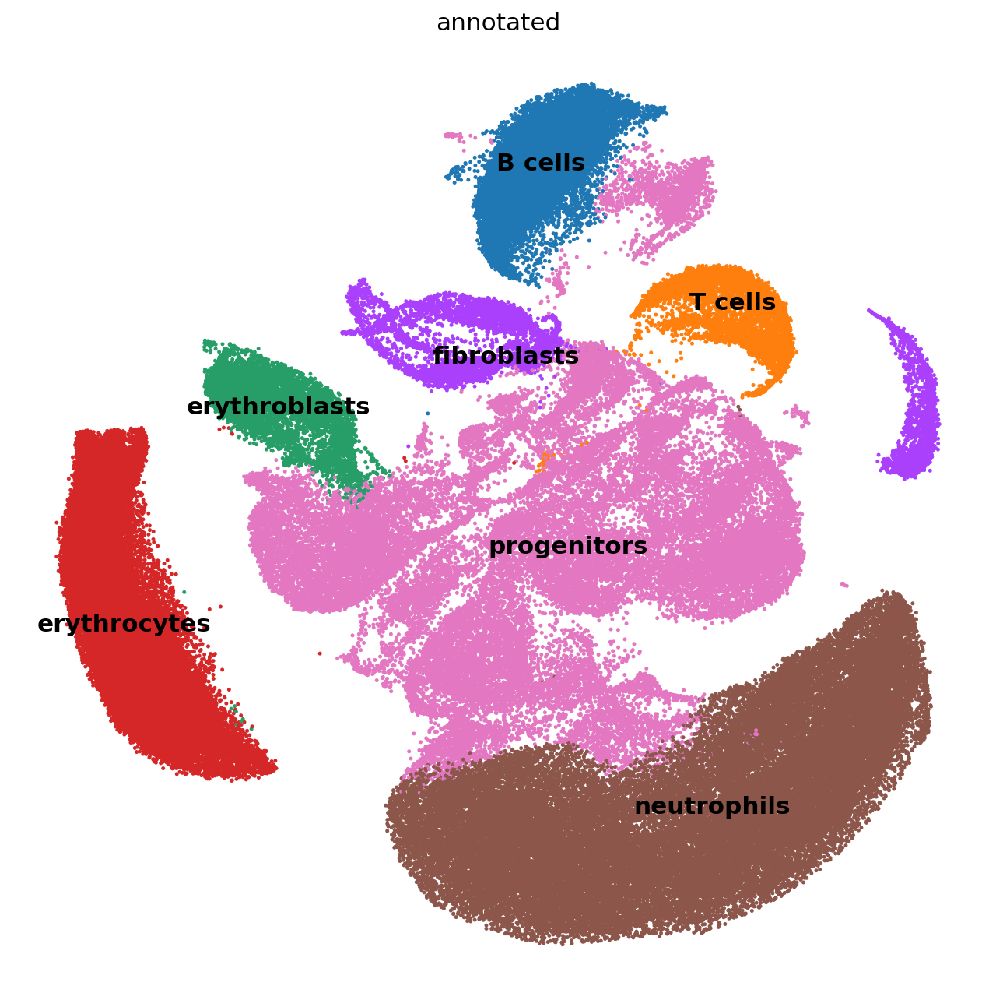

In [50]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata, color='annotated', legend_loc = 'on data', frameon=False, size=20)

## Resolve progenitors for annotation

In [51]:
adata_pro = adata[adata.obs['annotated']=='progenitors'].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Recompute embedding.

In [52]:
sc.pp.pca(adata_pro)
sc.pp.neighbors(adata_pro)
sc.tl.umap(adata_pro)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:42)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:21)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:27)


In [53]:
sc.tl.leiden(adata_pro, resolution=1)

running Leiden clustering
    finished: found 40 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:17)


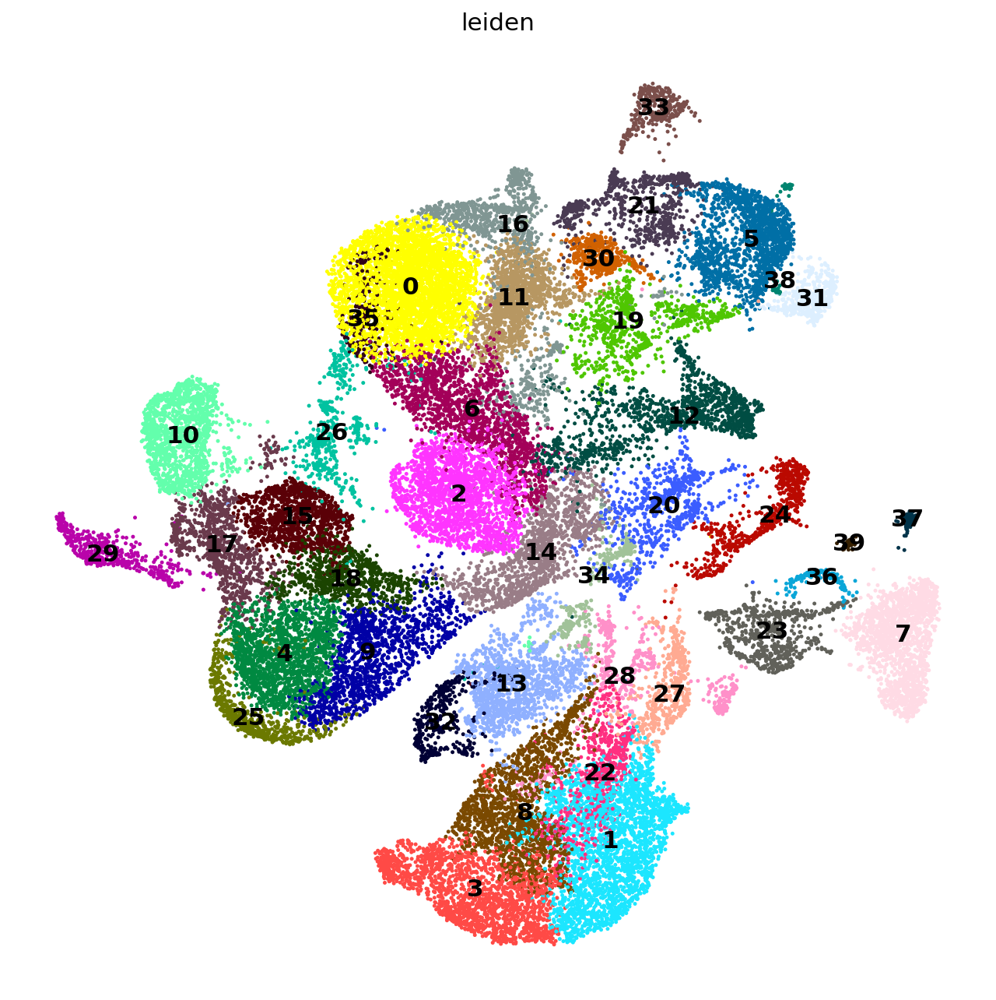

In [54]:
sc.pl.umap(adata_pro, color='leiden', legend_loc='on data', frameon=False,size=20)

In [55]:
adata_tmpp = adata.copy()

In [56]:
adata_tmpp.obs['tmp'] = 'nan'
adata_tmpp.obs.loc[adata_pro.obs.index,'tmp'] = adata_pro.obs['leiden'].values

... storing 'tmp' as categorical


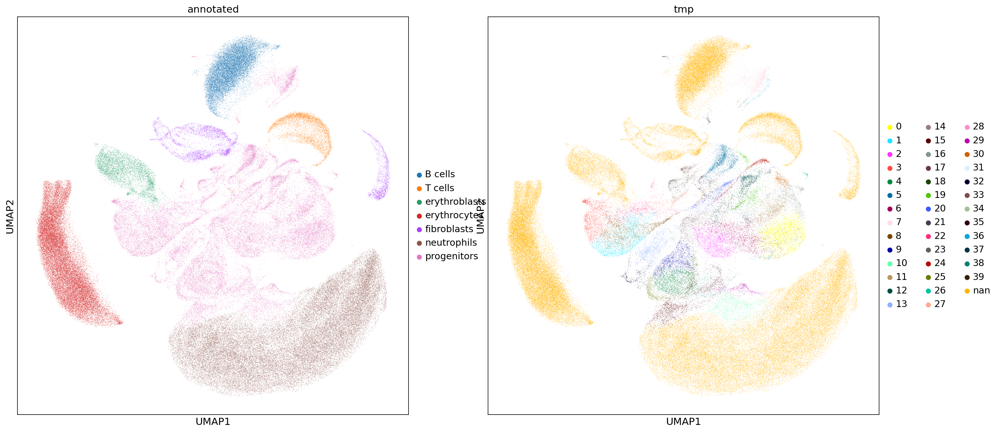

In [57]:
sc.pl.umap(adata_tmpp,color=['annotated','tmp'])

In [58]:
sc.tl.rank_genes_groups(adata_pro, groupby='leiden', method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:06:43)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


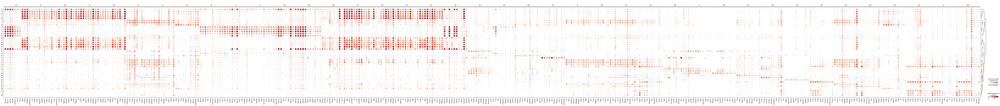

In [59]:
sc.tl.dendrogram(adata_pro, groupby='leiden')
sc.pl.rank_genes_groups_dotplot(adata_pro)

### Again for progenitors: Remap old celltype annotations to new data

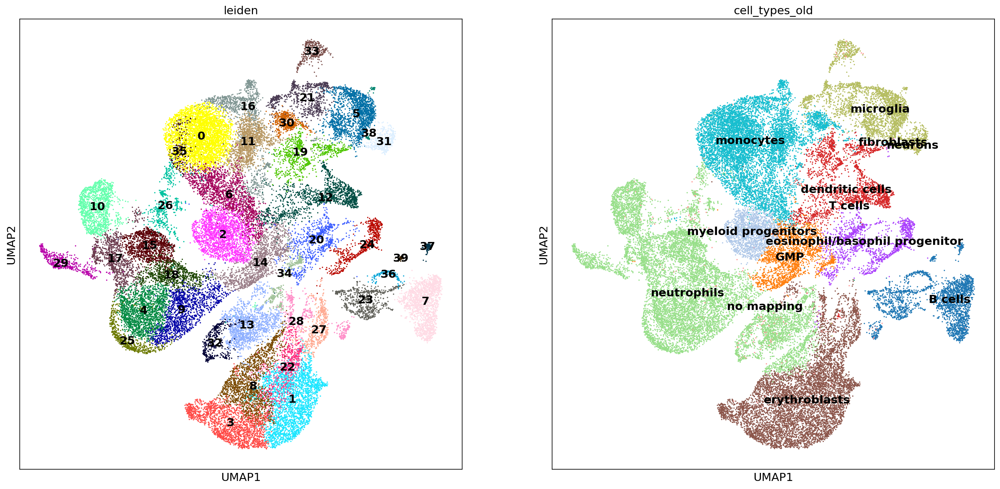

In [60]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata_pro, color=['leiden','cell_types_old'], size=10, legend_loc='on data')

In [61]:
leiden_mapping = {}
for i in range(max([int(l) for l in adata_pro.obs['leiden'].unique()])):
    leiden_mapping[str(i)] = adata_pro.obs.loc[adata_pro.obs['leiden'] == str(i),'cell_types_old'].value_counts().idxmax()

In [62]:
pd.DataFrame(index=leiden_mapping,data=[v for _,v in leiden_mapping.items()])

,0
0,monocytes
1,erythroblasts
2,myeloid progenitors
3,erythroblasts
4,neutrophils
5,microglia
6,monocytes
7,B cells
8,erythroblasts
9,neutrophils


We find the following cell type identities from the gene expression analysis:

- neutrophils: 9, 23, 25, 30 (S100a9, Retlng), 31 (early neutrophil, Elane, GMP like)   
  (woSham: neutrophils: 1, 7, 25 (S100a9, Retlng))
- microglia: 2, 14, 24, 28, 35 (C1qa-c)   
  (woSham: microglia: 4,19, 29,33 (C1qa-c))
- monocytes: 0, 6, 8, 12, 29 (Ccr2), 21 (special, closest to monocytes, Fcgr4 and Ace are specific for 21)   
  (woSham: monocytes: 0, 6, 17)
- GMP (granulocyte/monocyte progenitor):  7, 27 (Mpo, Elane)   
  (woSham: GMP (granulocyte/monocyte progenitor):  28 (Apoe expression))
- eosinophil/basophil progenitor: 16, 19 (Gata2)   
  (woSham: eosinophil/basophil progenitor: 21, 22 (Gata2))
- dendritic cells: 11, 26 (Bst2, Irf8), 13 (H2-* genes)   
  (woSham: dendritic cells: 13, (Bst2, Irf8), 18 (H2-* genes))
- NK cells: none (Nkg7)   
  (woSham: NK cells: 12, 30 (Nkg7) )
- erythroblasts: 1, 5, 10, 15, 17, 20 (Hbb-bs, Hbb-bt, Hba-a1, Hba-a2), 22 (very early, closest to erythroblasts)   
  (woSham: erythroblasts: 2, 5, 9, 11, 24, 26, 32, 34, 35 (Hbb-bs, Hbb-bt, Hba-a1, Hba-a2))
- B cells: 4, 18, 33, 34 (Jchain, Igkc, Cd79a-b) 32 (pre-B cell, Vpreb1+3)   
  (woSham: B cells: 38 (Jchain, Igkc), 20 (Cd79a-b) )
- myeloid progenitors: 3 

**new version**
- pro neutrophils 4, 9, 10, 15, 17, 18, 25, 26, 29
- myeloid progenitors 2, 14, 20, 34
- monocytes 0, 6, 11, 16, 30, 35
- eosinophil/basophil progenitor 24
- erythroblasts 1, 3, 8, 13, 22, 27, 28, 32
- B cells 7, 23, 36, 37, 39
- dendritic cells 12, 19
- microglia 5, 21, 31, 33, 38

In [63]:
annotate_pro_dict={
'0' : 'monocytes',
'1' : 'erythroblasts', 
'2' : 'myeloid progenitors',
'3' : 'erythroblasts', 
'4' : 'pro neutrophils', 
'5' : 'microglia',
'6' : 'monocytes',
'7' : 'B cells',
'8' : 'erythroblasts', 
'9' : 'pro neutrophils', 
'10' : 'pro neutrophils', 
'11' : 'monocytes',
'12' : 'dendritic cells',
'13' : 'erythroblasts',
'14' : 'myeloid progenitors',
'15' : 'pro neutrophils',
'16' : 'monocytes',
'17' : 'pro neutrophils',
'18' : 'pro neutrophils',
'19' : 'dendritic cells',
'20' : 'myeloid progenitors',
'21' : 'microglia',
'22' : 'erythroblasts', 
'23' : 'B cells',
'24' : 'eosinophil/basophil progenitor',
'25' : 'pro neutrophils', 
'26' : 'pro neutrophils',
'27' : 'erythroblasts',
'28' : 'erythroblasts',
'29' : 'pro neutrophils',
'30' : 'monocytes', 
'31' : 'microglia', 
'32' : 'erythroblasts',
'33' : 'microglia',
'34' : 'myeloid progenitors',
'35' : 'monocytes',
'36' : 'B cells',
'37' : 'B cells',
'38' : 'microglia',
'39' : 'B cells',
}

In [64]:
adata_pro.obs['annotated'] = adata_pro.obs['leiden'].map(annotate_pro_dict).astype('category')

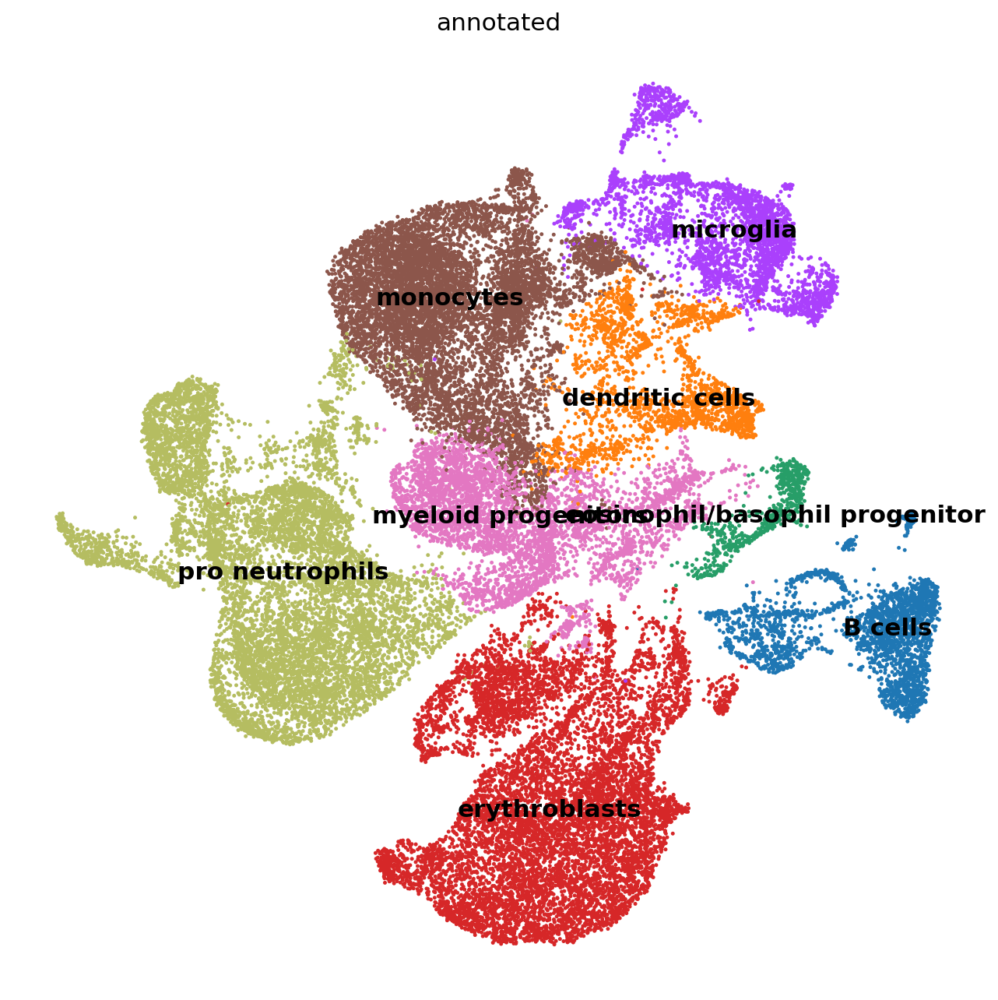

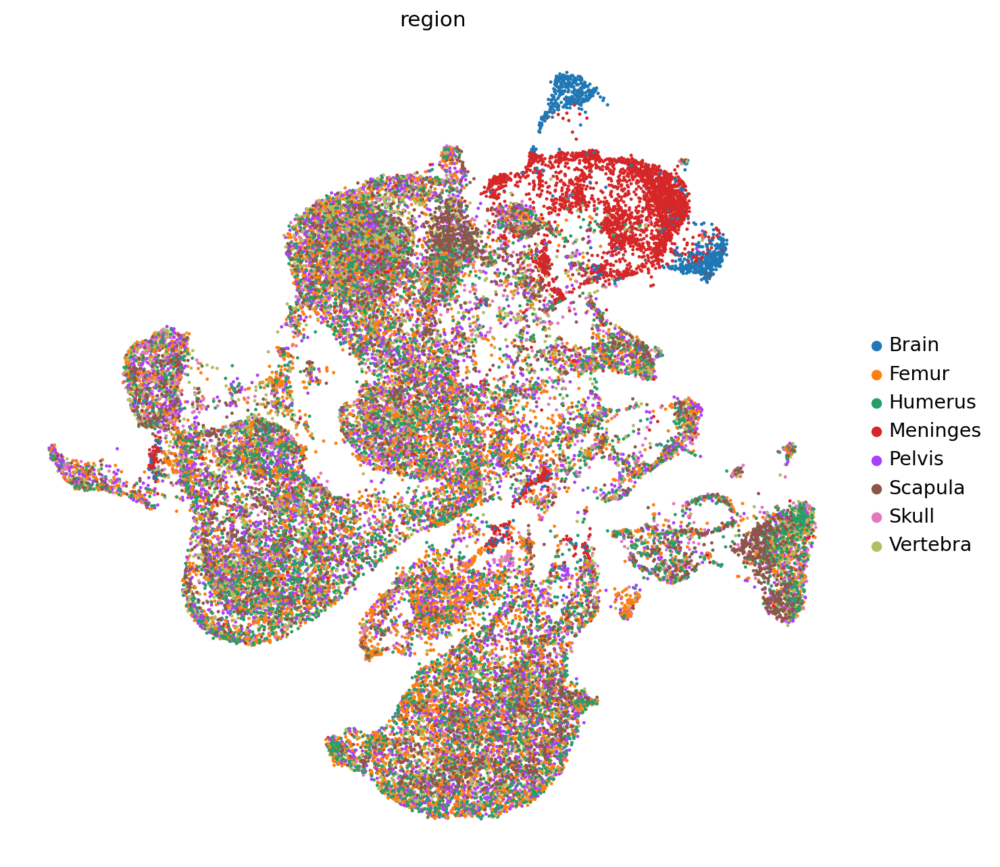

In [65]:
sc.pl.umap(adata_pro, color='annotated', legend_loc='on data', frameon=False,size=20)
sc.pl.umap(adata_pro, color='region', frameon=False,size=20)

In [66]:
adata_pro.obs['annotated'].value_counts()

erythroblasts                     9299
pro neutrophils                   8964
monocytes                         8520
myeloid progenitors               4193
microglia                         3217
B cells                           2523
dendritic cells                   2106
eosinophil/basophil progenitor     609
Name: annotated, dtype: int64

In [67]:
sc.tl.rank_genes_groups(adata_pro, groupby='annotated', method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:46)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['annotated']"]`


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


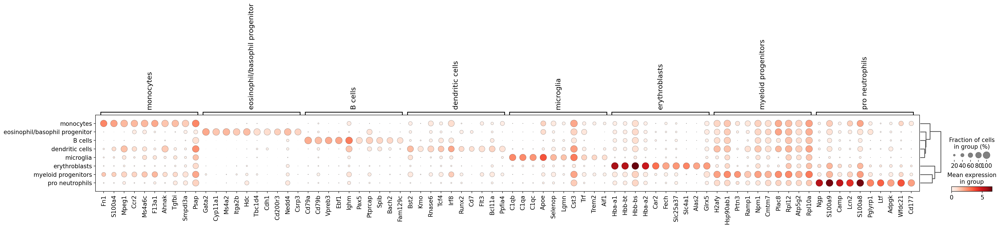

In [68]:
sc.tl.dendrogram(adata_pro, groupby='annotated')
sc.pl.rank_genes_groups_dotplot(adata_pro)

## Merge annotation of progenitors with full dataset

In [75]:
adata.obs['cell_types'] = adata.obs['annotated'].cat.add_categories(['dendritic cells', 'pro neutrophils', #'GMP', 'NK cells', 
       'eosinophil/basophil progenitor', 'microglia',
       'monocytes', 'myeloid progenitors'])
adata_pro.obs['annotated'] = adata_pro.obs['annotated'].cat.add_categories(['T cells','fibroblasts','progenitors','erythrocytes','neutrophils'])
adata.obs['cell_types'].loc[adata.obs['annotated']=='progenitors'] = adata_pro.obs['annotated'].values
adata.obs['cell_types'] = adata.obs['cell_types'].cat.remove_unused_categories()

In [76]:
adata.obs['cell_types'].value_counts()

neutrophils                       43252
erythrocytes                      31605
B cells                           18611
erythroblasts                     14959
pro neutrophils                    8964
monocytes                          8520
fibroblasts                        6112
T cells                            5199
myeloid progenitors                4193
microglia                          3217
dendritic cells                    2106
eosinophil/basophil progenitor      609
Name: cell_types, dtype: int64

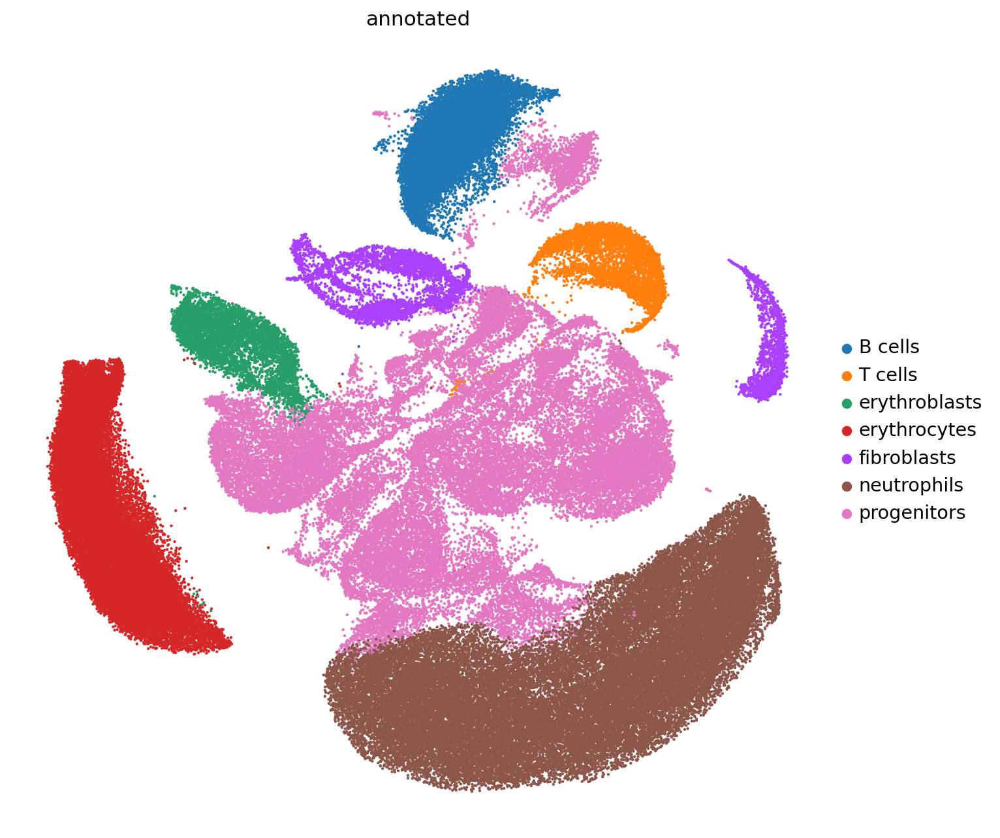

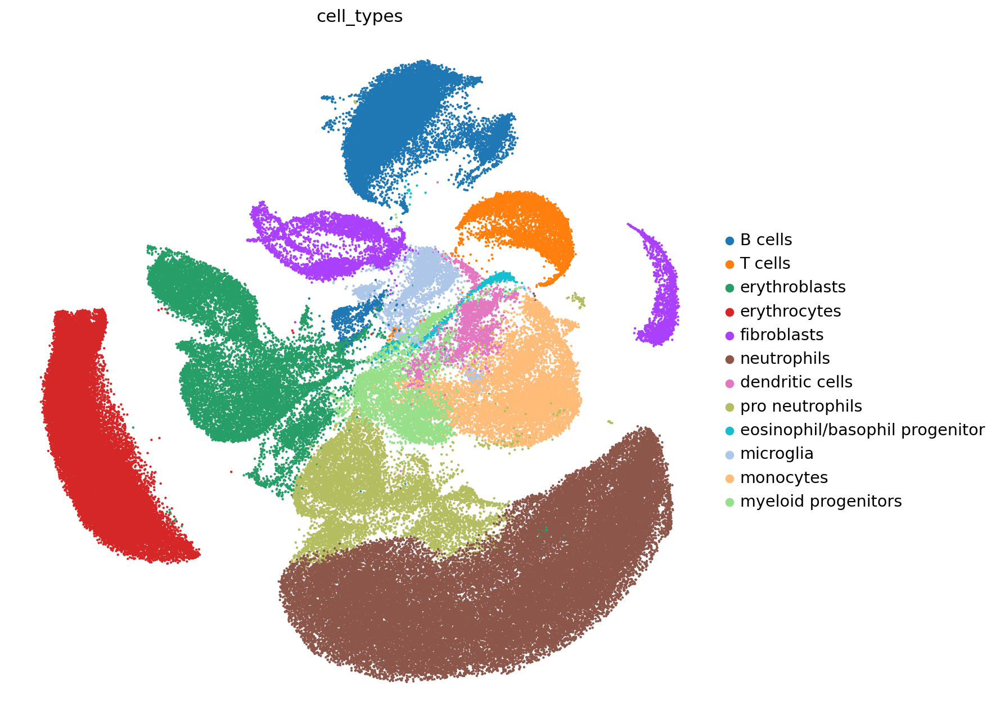

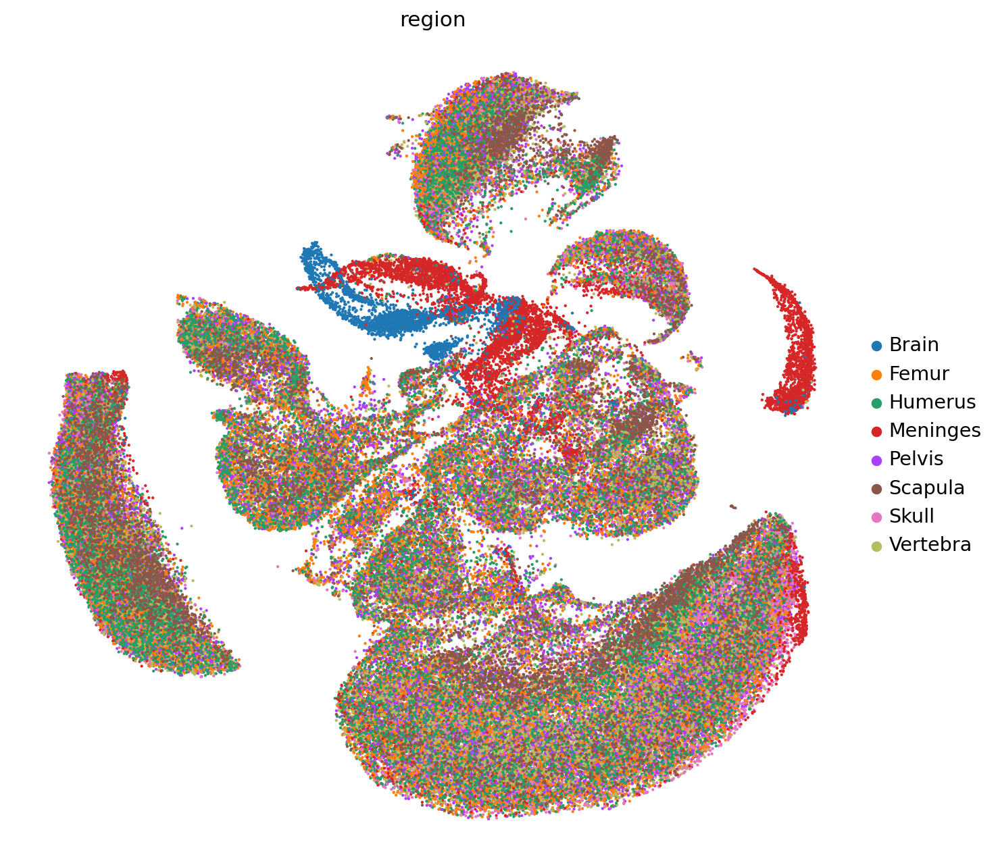

In [78]:
rcParams['figure.figsize']=(10,10)

sc.pl.umap(adata, color='annotated', size=15, frameon=False)#, legend_loc='on data'
sc.pl.umap(adata, color='cell_types', size=15, frameon=False)#, legend_loc='on data'
sc.pl.umap(adata, color='region', size=15, frameon=False)#, legend_loc='on data'

# Save to file

In [79]:
from scipy import sparse
if not sparse.issparse(adata.X):
     adata.X = sparse.csr_matrix(adata.X)

In [80]:
sc.write(adata=adata, filename= DATA_DIR+f'cellxgene_{DATA_VERSION}_wSham.h5ad')